In [12]:
import yfinance as yf
import requests
import pandas as pd
import pickle 
import os
import matplotlib.pyplot as plt
from matplotlib.font_manager import FontProperties

In [17]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_curve, auc

In [19]:
import torch
import torch.nn as nn
import torch.optim as optim

In [2]:
# Define the file paths
file_paths = ["index_history.pkl", "saved_indexes.pkl", "saved_symbols.pkl", "ticker_history.pkl", "event_clean.pkl"]

# Load the data from each file
data_dict = {}

for path in file_paths:
    with open(path, "rb") as file:
        data = pickle.load(file, encoding='latin1')
        data_dict[path] = data

# Access the loaded data
index_history = data_dict["index_history.pkl"]
saved_indices = data_dict["saved_indexes.pkl"]
saved_tickers = data_dict["saved_symbols.pkl"]
ticker_history = data_dict["ticker_history.pkl"]
event_history = data_dict["event_clean.pkl"]

# Print some information about the loaded data (optional)
print("Index History:", type(index_history), len(index_history))
print("Saved Indices:", type(saved_indices), len(saved_indices))
print("Saved Tickers:", type(saved_tickers), len(saved_tickers))
print("Ticker History:", type(ticker_history), len(ticker_history))
print("Earning History:", type(event_history), len(event_history))

Index History: <class 'dict'> 20
Saved Indices: <class 'list'> 20
Saved Tickers: <class 'list'> 101
Ticker History: <class 'dict'> 101
Earning History: <class 'dict'> 101


In [3]:
us_indices = ['^GSPC','^DJI','^IXIC','^NYA','^XAX','^RUT']
closing_time_from_midnight = pd.DateOffset(hours=16) # Closing time of NYSE(4pm). Closing time matters because we want
# to determine if the closing time is before or after event. # For pre-market earning events, 
# the 'before' data should not include the data from that day. 

closing_time_from_midnight_ind = {}
us_indices = ['^GSPC','^DJI','^IXIC','^NYA','^XAX','^RUT']
for ind in us_indices:
    closing_time_from_midnight_ind[ind] = pd.DateOffset(hours=16) # Closing time of NYSE
closing_time_from_midnight_ind['^VIX'] = pd.DateOffset(hours=15.25)
closing_time_from_midnight_ind['^BUK100P'] = pd.DateOffset(hours=17.5)
closing_time_from_midnight_ind['^FTSE'] = pd.DateOffset(hours=16.5)
closing_time_from_midnight_ind['^GDAXI'] = pd.DateOffset(hours=18)
closing_time_from_midnight_ind['^FCHI'] = pd.DateOffset(hours=17.5)
closing_time_from_midnight_ind['^STOXX50E'] = pd.DateOffset(hours=18)
closing_time_from_midnight_ind['^N100'] = pd.DateOffset(hours=17.5)
closing_time_from_midnight_ind['^BFX'] = pd.DateOffset(hours=17.5)
closing_time_from_midnight_ind['IMOEX.ME'] = pd.DateOffset(hours=16)
closing_time_from_midnight_ind['^N225'] = pd.DateOffset(hours=15)
closing_time_from_midnight_ind['^HSI'] = pd.DateOffset(hours=16)
closing_time_from_midnight_ind['000001.SS'] = pd.DateOffset(hours=15)
closing_time_from_midnight_ind['399001.SZ'] = pd.DateOffset(hours=15)
closing_time_from_midnight_ind['^STI'] = pd.DateOffset(hours=17)

In [4]:
# Using last num_days_before trading days. We dont care about when those days occured relative to each other
def earnings_data_no_of_trading_days(num_days_before,num_days_after):

    d = {}
    
    indices = saved_indices

    for sym in event_history:
        dum = []
        event_date = event_history[sym].index

        for j in range(len(event_history[sym])):
            dic = {"Before":0, "After":0, "Earning":0}
            dic['Earning'] = event_history[sym].iloc[[j]]

            ticker_closing = ticker_history[sym].index+closing_time_from_midnight
            dfb = ticker_history[sym][["Close"]][ticker_closing<=event_date[j]]
            dfb.sort_index(inplace=True)
            dfb = dfb[-num_days_before:]
            dfb = dfb.rename(columns = {"Close":sym})
            dfb.index = range(-len(dfb),0,1)
            for ind in indices:
                index_closing = index_history[ind].index+closing_time_from_midnight_ind[ind]
                dfbi = index_history[ind][["Close"]][index_closing<=event_date[j]]            
                dfbi.sort_index(inplace=True)
                dfbi = dfbi[-num_days_before:]
                dfbi = dfbi.rename(columns={"Close":ind})
                dfbi.index = range(-len(dfbi),0,1)
                dfb = dfb.join(dfbi)
            dic["Before"] = dfb

            ticker_closing = ticker_history[sym].index+closing_time_from_midnight
            dfa = ticker_history[sym][["Close"]][ticker_closing>event_date[j]]
            dfa.sort_index(inplace=True)
            dfa = dfa[:num_days_after]
            dfa = dfa.rename(columns = {"Close":sym})
            dfa.index = range(1,len(dfa)+1)
            for ind in indices:
                index_closing = index_history[ind].index+closing_time_from_midnight_ind[ind]
                dfai = index_history[ind][["Close"]][index_closing>event_date[j]]            
                dfai.sort_index(inplace=True)
                dfai = dfai[:num_days_after]
                dfai = dfai.rename(columns={"Close":ind})
                dfai.index = range(1,len(dfai)+1)
                dfa = dfa.join(dfai)
            dic["After"] = dfa

            dum.append(dic)
        d[sym] = dum
    return d

In [5]:
d = earnings_data_no_of_trading_days(30,7)

In [6]:
import statsmodels.api as sm
import numpy as np
import pandas as pd

def calculate_expected_returns(ticker, index):
    # Get the closing prices for the ticker and index
    ticker_df = ticker_history[ticker]
    index_df = index_history[index]
    
    # Calculate daily returns
    ticker_returns = np.log(ticker_df['Close'] / ticker_df['Close'].shift(1)).dropna()
    index_returns = np.log(index_df['Close'] / index_df['Close'].shift(1)).dropna()
    
    # Align the returns
    returns_df = pd.DataFrame({'Ticker': ticker_returns, 'Index': index_returns}).dropna()
    
    # Fit the market model
    X = sm.add_constant(returns_df['Index'])
    model = sm.OLS(returns_df['Ticker'], X).fit()
    
    # Predict the expected returns
    expected_returns = model.predict(X)
    
    returns_df['Expected'] = expected_returns
    returns_df['Abnormal'] = returns_df['Ticker'] - returns_df['Expected']
    
    return returns_df

def calculate_car(ticker, index, event_date, window=10):
    returns_df = calculate_expected_returns(ticker, index)
    
    # Calculate CAR before and after the earnings announcement
    car_before = returns_df.loc[event_date - pd.DateOffset(days=window):event_date, 'Abnormal'].sum()
    car_after = returns_df.loc[event_date:event_date + pd.DateOffset(days=window), 'Abnormal'].sum()
    
    return car_before, car_after

def label_car(car_before, car_after, threshold=0.05):
    if car_after > car_before * (1 + threshold):
        return 1  # Not Priced In
    else:
        return 0  # Priced In


In [7]:
X = []
Y = []
Z = []
tickers = []

def generate_variables(df):
    for sym in df:
        for evt_idx in range(len(df[sym])):
            df_sym_idx = df[sym][evt_idx]
            
            ticker_b = df_sym_idx['Before'][sym].values
            index_b = df_sym_idx['Before']['^GSPC'].values
            ticker_a = df_sym_idx['After'][sym].values
            index_a = df_sym_idx['After']['^GSPC'].values
            
            if len(ticker_b) == 30 and len(index_b) == 30:
                ticker_0 = ticker_b[-1]
                index_0 = index_b[-1]
                
                ticker_b = np.log10(ticker_b / ticker_0)
                index_b = np.log10(index_b / index_0)
                
                surprise = df_sym_idx['Earning']['Surprise(%)'].values
                
                x = np.concatenate((ticker_b, index_b, surprise))
                
                # Calculate CAR and label
                event_date = df_sym_idx['Earning'].index[0]  # Assuming the earnings date is the index
                car_before, car_after = calculate_car(sym, '^GSPC', event_date)
                y = label_car(car_before, car_after)
                
                ticker_a = np.log10(ticker_a / ticker_0)
                index_a = np.log10(index_a / index_0)
                
                z = np.concatenate((ticker_a, index_a))
                X.append(x)
                Y.append(y)
                Z.append(z)
                tickers.append(sym)


generate_variables(d)


In [8]:
d

{'ADBE': [{'Before':            ADBE        ^GSPC          ^DJI         ^IXIC          ^NYA  \
   -30  544.500000  4237.859863  33274.578125  13061.469727  15002.549805   
   -29  558.710022  4317.779785  33839.078125  13294.190430  15332.599609   
   -28  563.659973  4358.339844  34061.320312  13478.280273  15475.200195   
   -27  565.450012  4365.979980  34095.859375  13518.780273  15440.500000   
   -26  585.200012  4378.379883  34152.601562  13639.860352  15388.490234   
   -25  585.309998  4382.779785  34112.269531  13650.410156  15352.190430   
   -24  577.739990  4347.350098  33891.941406  13521.450195  15235.179688   
   -23  597.219971  4415.240234  34283.101562  13798.110352  15388.440430   
   -22  590.340027  4411.549805  34337.871094  13767.740234  15403.139648   
   -21  604.330017  4495.700195  34827.699219  14094.379883  15732.669922   
   -20  595.309998  4502.879883  34991.210938  14103.839844  15765.019531   
   -19  602.059998  4508.240234  34945.468750  14113.66992

In [9]:
X = np.array(X)
Y = np.array(Y)
Z = np.array(Z)
tickers = np.array(tickers)

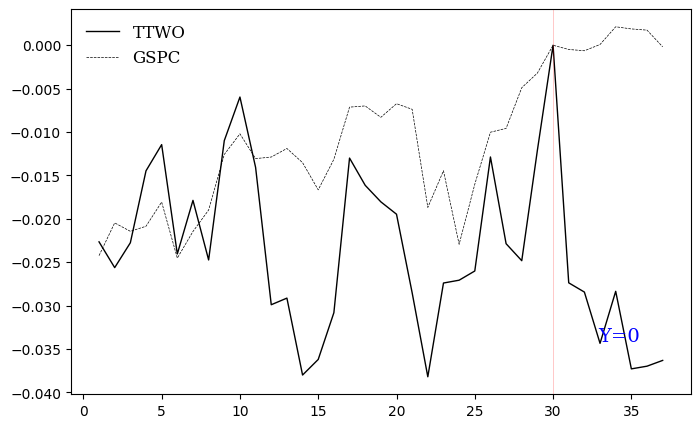

In [13]:
# Plot the histories
def plot_histories(save_fig=False):
    q = np.random.randint(X.shape[0])

    fig, ax = plt.subplots(1, 1, figsize=(8, 5))

    ticker_ts = np.concatenate((X[q][:30], Z[q][:7]))
    index_ts = np.concatenate((X[q][30:60], Z[q][7:]))

    days = np.arange(1, 38, 1)
    ax.plot(days, ticker_ts, color='k', lw=1.0, label=tickers[q])
    ax.plot(days, index_ts, color='k', lw=0.5, ls='--', label='GSPC')
    ax.axvline(x=30, color='r', linestyle='-', linewidth=0.5, alpha=0.3)

    font_properties = FontProperties(family='serif', size=12)
    plt.legend(frameon=False, prop=font_properties)

    ax.text(0.85, 0.15, 'Y={}'.format(Y[q]), transform=ax.transAxes, verticalalignment='center', fontsize=14, fontfamily='serif', color='b')

    if save_fig:
        plt.savefig('history_views/{}_GSPC_history.png'.format(tickers[q]), dpi=300, bbox_inches='tight')

    plt.show()

# Plot example
plot_histories()

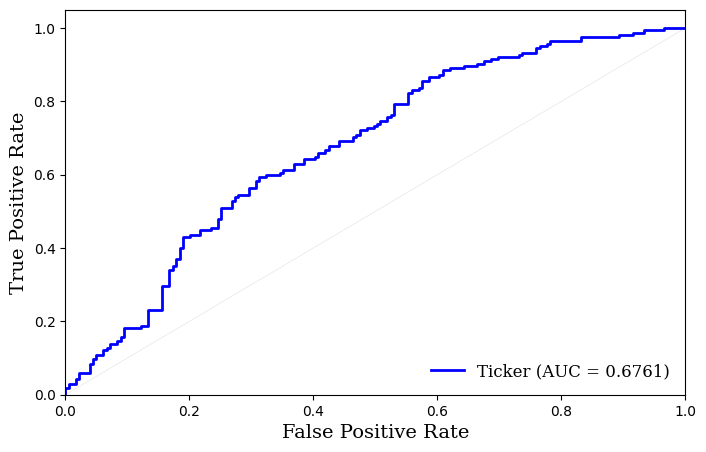

In [18]:
# Assuming X and Y are already defined and populated
X = np.array(X)
Y = np.array(Y)

# Step 1: Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=22)

# Step 2: Train Logistic Regression Model
logreg_model = LogisticRegression(solver='liblinear')
logreg_model.fit(X_train, y_train)

# Step 3: Predict Probabilities
y_pred_prob_logreg = logreg_model.predict_proba(X_test)[:, 1]

# Step 4: Calculate and Plot ROC Curve
fpr_logreg, tpr_logreg, _ = roc_curve(y_test, y_pred_prob_logreg)
roc_auc_logreg = auc(fpr_logreg, tpr_logreg)

plt.figure(figsize=(8, 5))
plt.plot(fpr_logreg, tpr_logreg, color='blue', lw=2, label='Ticker (AUC = %0.4f)' % roc_auc_logreg)
plt.plot([0, 1], [0, 1], color='k', lw=0.5, linestyle='-', alpha=0.1)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate', fontsize=14, fontfamily='serif')
plt.ylabel('True Positive Rate', fontsize=14, fontfamily='serif')

font_properties = FontProperties(family='serif', size=12)
plt.legend(loc='lower right', frameon=False, prop=font_properties)

plt.savefig('ticker_GSPC_result.png', dpi=300, bbox_inches='tight')
plt.show()

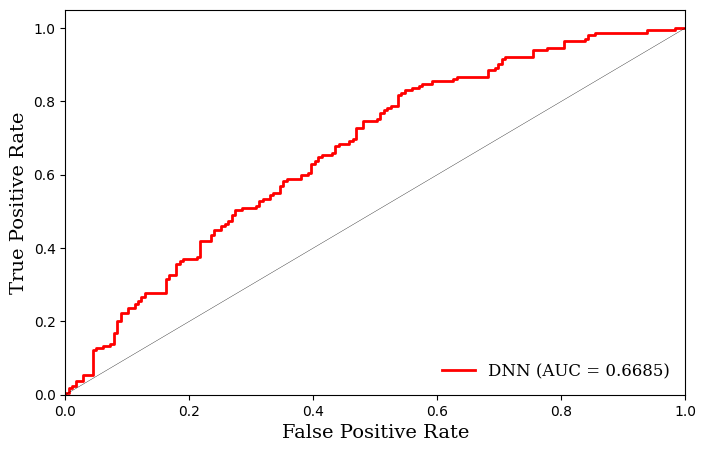

In [20]:
# Step 1: Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=22)

# Step 2: Define the Neural Network
class SimpleNN(nn.Module):
    def __init__(self, input_dim):
        super(SimpleNN, self).__init__()
        self.fc1 = nn.Linear(input_dim, 64)
        self.fc2 = nn.Linear(64, 32)
        self.fc3 = nn.Linear(32, 1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        x = torch.relu(self.fc1(x))
        x = torch.relu(self.fc2(x))
        x = self.fc3(x)
        x = self.sigmoid(x)
        return x

# Convert data to PyTorch tensors
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32).view(-1, 1)
X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test, dtype=torch.float32).view(-1, 1)

# Initialize and train the neural network
input_dim = X_train.shape[1]
model = SimpleNN(input_dim)
criterion = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

num_epochs = 100
for epoch in range(num_epochs):
    model.train()
    optimizer.zero_grad()
    outputs = model(X_train_tensor)
    loss = criterion(outputs, y_train_tensor)
    loss.backward()
    optimizer.step()

# Predict probabilities on the test set
model.eval()
with torch.no_grad():
    y_pred_prob_nn = model(X_test_tensor).numpy()

# Compute ROC curve and AUC for the neural network
fpr_nn, tpr_nn, _ = roc_curve(y_test, y_pred_prob_nn)
roc_auc_nn = auc(fpr_nn, tpr_nn)

# Plot ROC curve for the neural network
plt.figure(figsize=(8, 5))
plt.plot(fpr_nn, tpr_nn, color='r', lw=2, label='DNN (AUC = %0.4f)' % roc_auc_nn)
plt.plot([0, 1], [0, 1], color='k', lw=0.25, linestyle='-')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate', fontsize=14, fontfamily='serif')
plt.ylabel('True Positive Rate', fontsize=14, fontfamily='serif')
font_properties = FontProperties(family='serif', size=12)
plt.legend(loc='lower right', frameon=False, prop=font_properties)
plt.show()